In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
from os.path import join, basename
from skimage.util import img_as_ubyte
import skimage as ski
from skimage import filters
from skimage import exposure
import pandas as pd
from scipy.stats import norm
from scipy.stats import entropy

In [2]:
# Your file paths
DATAROOT = r"E:\Documentos\01_DTU\DTU-TFM\Fotos\Real DOE\UV\Cropped\PP black cropped"

#This part sorts the list of file paths. 
# It uses a lambda function as the key parameter for the sorted() function. 
# The lambda function takes a file path x as input, extracts the base name of the file using basename(x),
#splits the base name on the period character to separate the file name from the extension, takes the first element of the resulting list (the file name without the extension), converts it to an integer using int(), and returns it. This effectively sorts the file paths in numerical order based on the file names
image_files = sorted(glob.glob(join(DATAROOT, '*.png')), key=lambda x: int(basename(x).split('.')[0]))


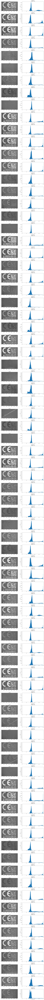

In [3]:
fig, axs = plt.subplots(len(image_files), 2, figsize=(15, 4 * len(image_files)))
# Calculate the histograms and contrast metric, and populate the subplots

# Create an empty DataFrame to store contrast results
Contrast_data = {'Image': [], 'Contrast': []}
Contrast_df = pd.DataFrame(Contrast_data)


for i in range(len(image_files)):
    load = cv2.imread(image_files[i])
    img = cv2.cvtColor(load, cv2.COLOR_BGR2GRAY)
    selection = img.copy()
    
    #Syntax: cv2.calcHist(images, channels, mask, histSize, ranges[, hist[, accumulate]])
    hist = cv2.calcHist([img], [0], None, [256], [0, 256])
    image_entropy = entropy(img.ravel())
    
    # Display the image
    axs[i, 0].imshow(selection, cmap='gray', vmin=0, vmax=256)
    axs[i, 0].set_title(f'{basename(image_files[i])}')
 
    # Display the histogram
    axs[i, 1].hist(img.ravel(),bins = 256,range=[0, 256])
    axs[i, 1].set_title(f'Histogram {i+1}\nContrast: {image_entropy:.2f}')
    axs[i, 1].set_xlabel('Intensity Value')
    axs[i, 1].set_ylabel('Count')
    axs[i, 1].set_xlim([0, 256])

    # Add results to the DataFrame
    Contrast_data['Image'].append(basename(image_files[i]))
    Contrast_data['Contrast'].append(np.std(img))

# Save the DataFrame to a CSV file
Contrast_df = pd.DataFrame(Contrast_data)
#Contrast_df.to_csv('Contrast_results_DOE__UV_PP_Black.csv', index=False)

plt.tight_layout()
plt.show()

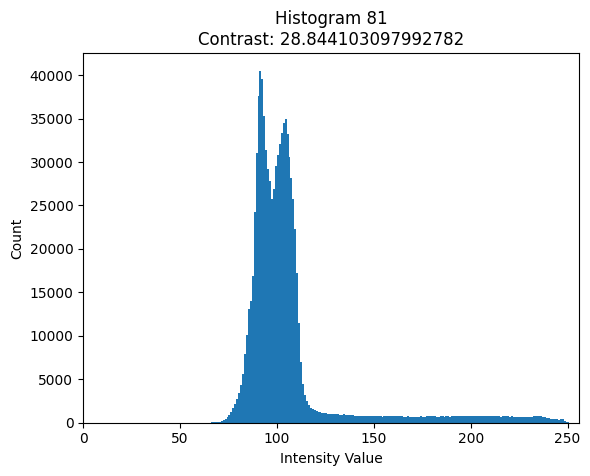

In [4]:
#Display one of the histograms
plt.hist(img.ravel(),bins = 256,range=[0, 256])
plt.title(f'Histogram {i+1}\nContrast: {np.std(img)}')
plt.xlabel('Intensity Value')
plt.ylabel('Count')
plt.xlim([0, 256])
plt.show()


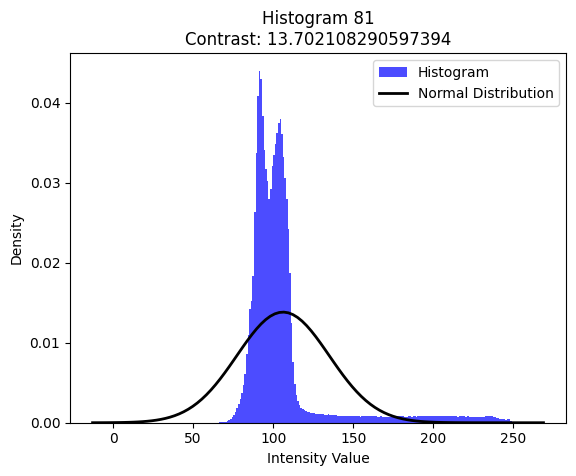

In [5]:
from scipy.stats import norm
from scipy.stats import entropy

# Plotting the histogram
plt.hist(img.ravel(), bins=256, range=[0, 256], density=True, alpha=0.7, color='b', label='Histogram')

# Calculating mean and standard deviation for the normal distribution
mean_value = np.mean(img)
std_dev = np.std(img)
image_entropy = entropy(img.ravel())
# Creating a normal distribution curve
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mean_value, std_dev)
plt.plot(x, p, 'k', linewidth=2, label='Normal Distribution')

# Setting plot labels and title
plt.title(f'Histogram {i+1}\nContrast: {image_entropy}')
plt.xlabel('Intensity Value')
plt.ylabel('Density')
plt.legend()

# Display the plot
plt.show()

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (2,) + inhomogeneous part.

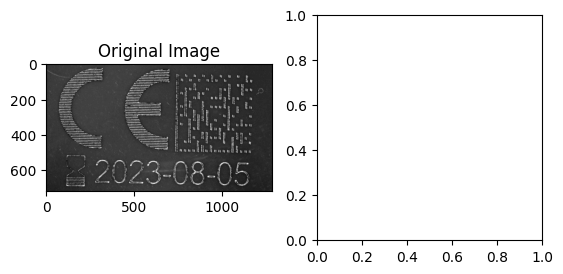

In [6]:
# Apply Otsu's thresholding
thresh_img = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Display the original and thresholded images
plt.subplot(121), plt.imshow(img, cmap='gray'), plt.title('Original Image')
plt.subplot(122), plt.imshow(thresh_img, cmap='gray'), plt.title('Thresholded Image')
plt.show()